In [1]:
import matplotlib.pyplot as plt
import numpy as np

## Pillow

In [2]:
from PIL import Image

In [3]:
path = './Data/image/nebula.jpg'
image = Image.open(path)

In [4]:
image.show(title='nebula')

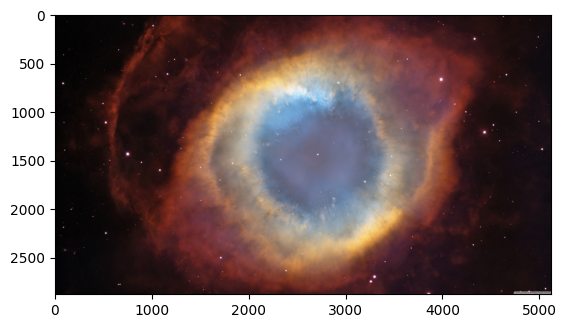

In [5]:
plt.imshow(image);

In [6]:
image.mode

'RGB'

In [7]:
image.size

(5120, 2880)

In [8]:
image.format

'JPEG'

In [9]:
from PIL import ImageOps

In [10]:
image_gry = ImageOps.grayscale(image)

In [11]:
image_gry.mode

'L'

The Quantization of an image is the number of unique intensity values any given pixel of the image can take. For a grayscale image, this means the number of different shades of gray. Most images have 256 different levels. You can decrease the levels using the method quantize

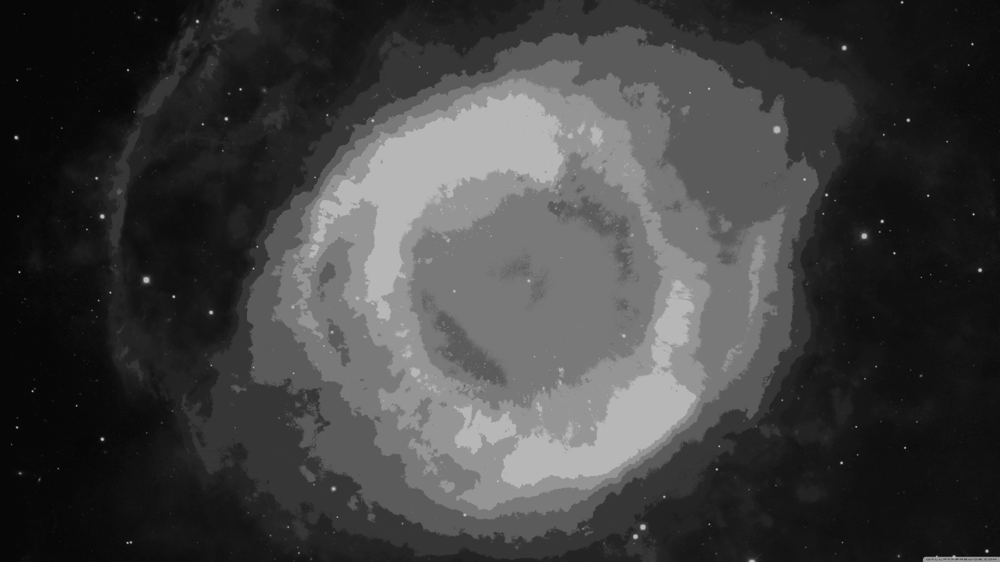

In [12]:
image_gry.quantize(10) # lossy compresed

In [13]:
red, green, blue = image.split()

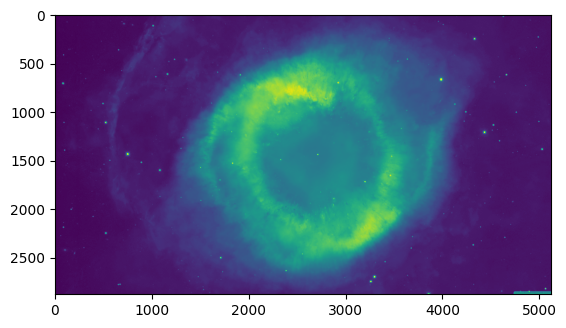

In [14]:
plt.imshow(green)

In [15]:
array= np.asarray(image)
print(type(array))

<class 'numpy.ndarray'>


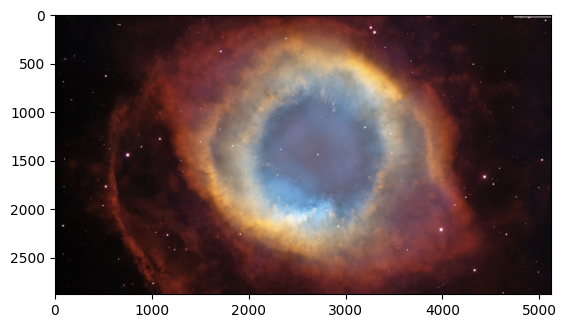

In [16]:
im_flip = ImageOps.flip(image)
plt.imshow(im_flip)

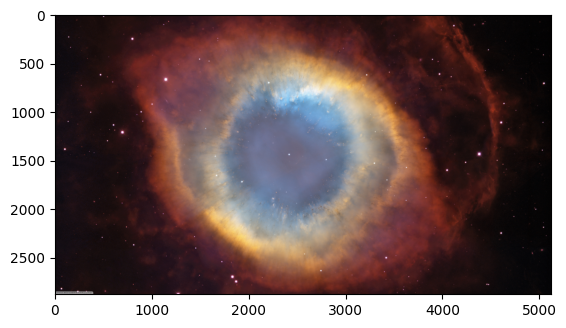

In [17]:
im_mirror = ImageOps.mirror(image)
plt.imshow(im_mirror)

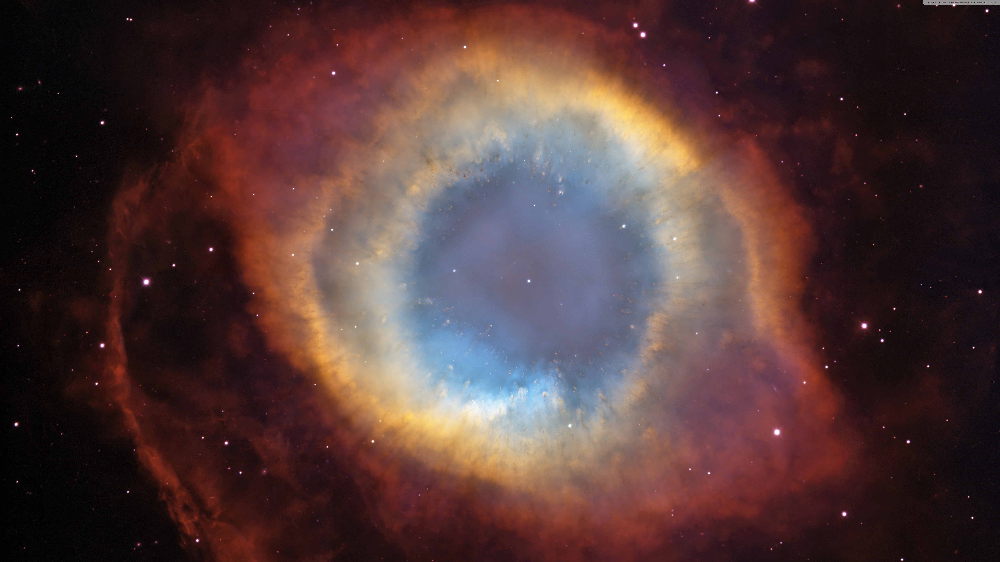

In [18]:
image.transpose(Image.FLIP_TOP_BOTTOM)

## Open cv

In [19]:
import cv2

In [20]:
image = cv2.imread(path)

In [21]:
type(image)

numpy.ndarray

In [22]:
image.shape

(2880, 5120, 3)

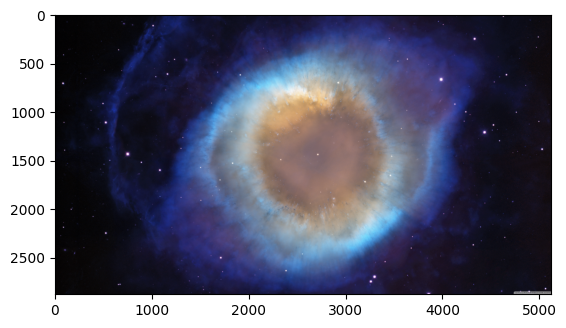

In [23]:
plt.imshow(image) # opencv color space is BGR unlike rgb

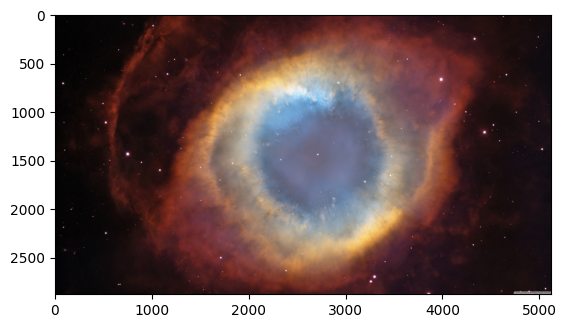

In [24]:
new_image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB) #Convert to RGB
plt.imshow(new_image)

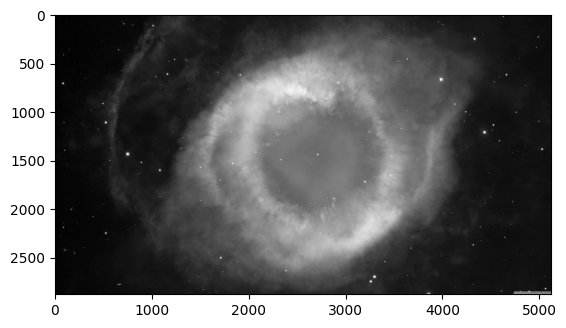

In [25]:
gray_image = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY) #  Convert to Gray
plt.imshow(gray_image,cmap='gray')

In [26]:
cv2.imwrite('nebula_gray.jpg',gray_image)

True

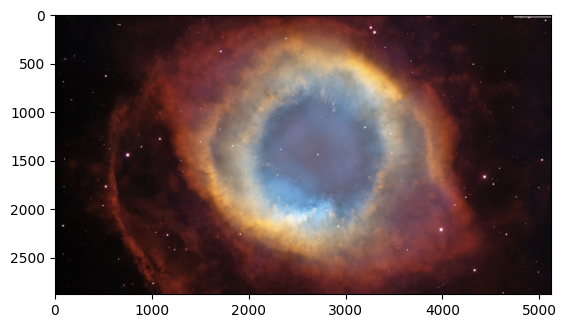

In [27]:
img_flip = cv2.flip(new_image,0) #y-asis
plt.imshow(img_flip)
plt.show()

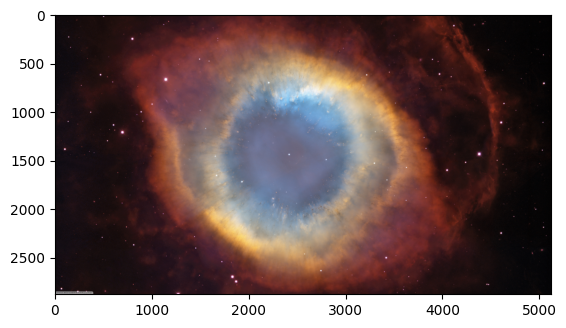

In [28]:
img_flip = cv2.flip(new_image,1) #x-axis
plt.imshow(img_flip)
plt.show()

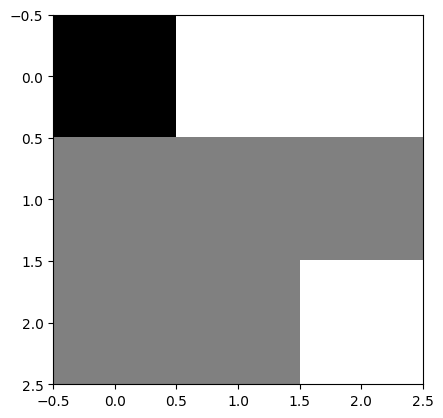

toy_image: [[0 2 2]
 [1 1 1]
 [1 1 2]]


In [29]:
toy_image = np.array([[0,2,2],[1,1,1],[1,1,2]],dtype=np.uint8)
plt.imshow(toy_image, cmap="gray")
plt.show()
print("toy_image:",toy_image)

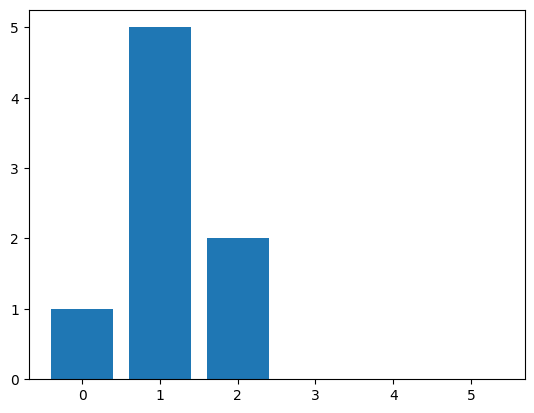

In [30]:
plt.bar([x for x in range(6)],[1,5,2,0,0,0])
plt.show()

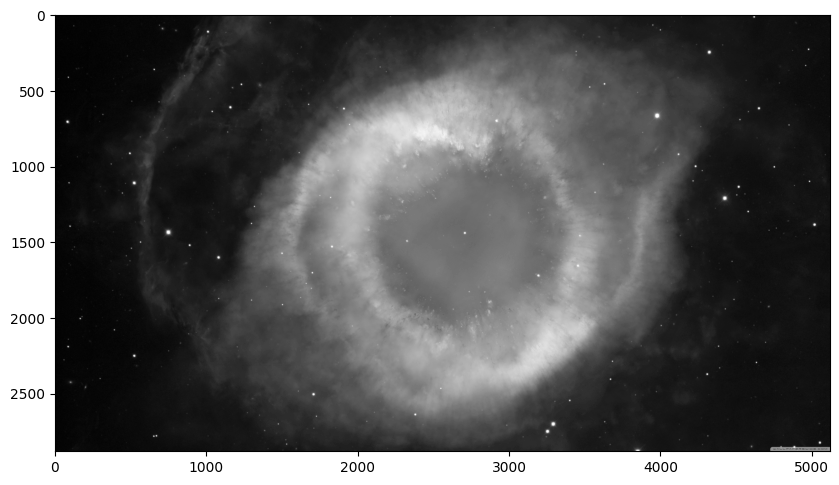

In [31]:
nebula = cv2.imread("nebula_gray.jpg",cv2.IMREAD_GRAYSCALE)
plt.figure(figsize=(10,10))
plt.imshow(nebula,cmap="gray")
plt.show()

In [32]:
hist = cv2.calcHist(nebula,[0],None,[256],[0,256])

In [33]:
hist.shape

(256, 1)

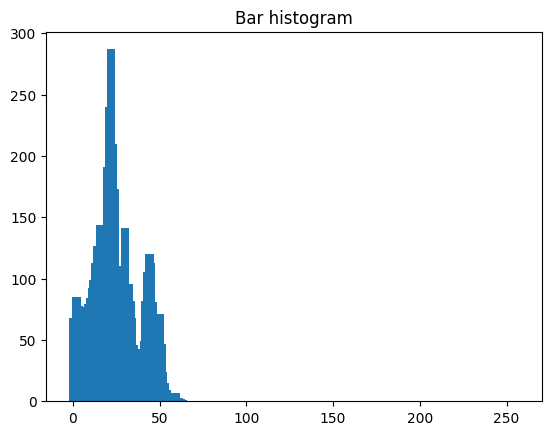

In [34]:
intensity_values = np.array([x for x in range(hist.shape[0])])
plt.bar(intensity_values, hist[:,0], width = 5)
plt.title("Bar histogram")
plt.show()

Convert it to a probability mass function by normalizing it by the number of pixels:

In [35]:
PMF = hist / (nebula.shape[0] * nebula.shape[1])

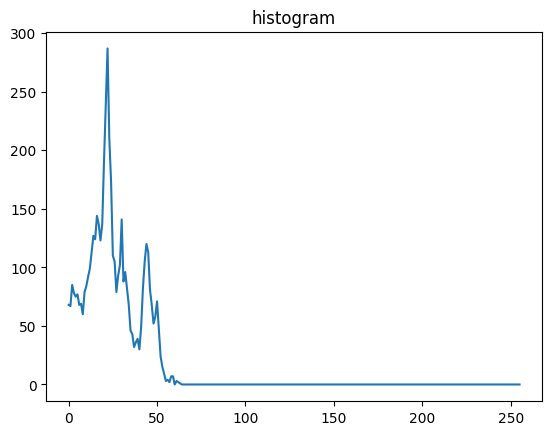

In [36]:
plt.plot(intensity_values,hist)
plt.title("histogram")
plt.show()

### Camera with opencv

In [3]:
import cv2
import matplotlib.pyplot as plt

In [38]:
cap = cv2.VideoCapture(0)

In [39]:
ret, frame = cap.read()

In [40]:
ret

True

In [41]:
frame.size

921600

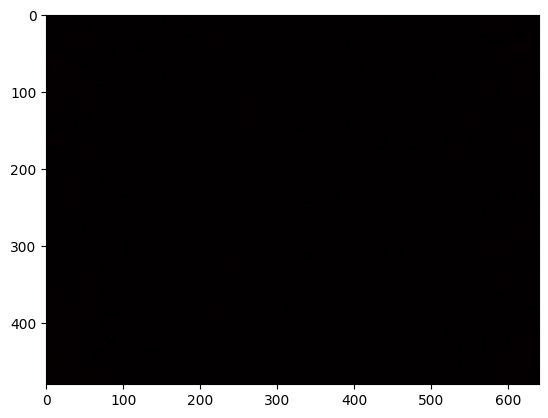

In [42]:
plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))

In [43]:
cap.release()

In [44]:
cv2.imwrite("test.jpg",frame)

True

In [45]:
def clickphoto():
    cap = cv2.VideoCapture(0)
    ret, frame = cap.read()
    cap.release()
    return frame

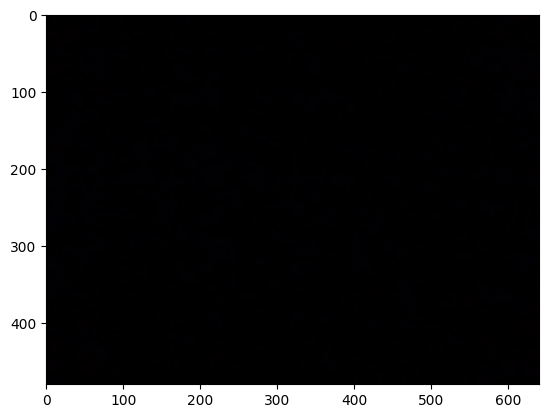

In [46]:
photo = clickphoto()
plt.imshow(cv2.cvtColor(photo, cv2.COLOR_BGR2RGB))

### Real time

In [16]:
cap = cv2.VideoCapture(0)
frames = []
while cap.isOpened():
    ret, frame = cap.read()
    cv2.imshow('feed', frame)
    frames.append(frame)

    if cv2.waitKey(1) & 0xFF == ord('i'):
        break
cap.release()
cv2.destroyAllWindows()



In [19]:
len(frames)

167

In [18]:
frames[1].shape

(480, 640, 3)